In [15]:
# Import the Format and Analyze classes from the utilities.cal_utils module
from utlities.cal_utils import Format
from utlities.cal_utils import Analyze

# Import various necessary libraries and modules
import pandas as pd  # Data manipulation and analysis
import matplotlib.pyplot as plt  # Plotting library
import matplotlib.gridspec as gridspec  # Grid layout for subplots
import matplotlib.ticker as ticker  # Import ticker module for custom tick formatting

import seaborn as sns  # Statistical data visualization
import math  # Mathematical functions
import scipy  # Scientific and technical computing
from scipy.signal import find_peaks  # Function to find peaks in data
import numpy as np  # Numerical computing
import os  # Miscellaneous operating system interfaces
from math import log10, floor

from scipy.signal import iirfilter
import numpy as np


# Define a representation string
rep = "3"

# Paths to data and metadata excel files, using f-strings for dynamic paths
path_data = f"./Data/rep{rep}_data.xlsx"
path_md = f"./Data/rep{rep}_md.xlsx"

# Define folder paths for outputs and graph options using f-strings
folder = f"./picker_outputs_rep{rep}"
option_graphs_folder_for_11mm = f"rep{rep}_11mM_option_graphs"
complete_graphs = f"rep{rep}_11mM_complete__graphs"

# Create Format object for data formatting, passing the data path
form = Format(path = path_data)
# Create Analyze object for data analysis
analyze = Analyze()

# Set the Seaborn style to "darkgrid" for better graph visibility
sns.set_style("darkgrid")
# Set Seaborn color palette to 'colorblind' mode for accessibility
sns.color_palette('colorblind')


[(0.00392156862745098, 0.45098039215686275, 0.6980392156862745),
 (0.8705882352941177, 0.5607843137254902, 0.0196078431372549),
 (0.00784313725490196, 0.6196078431372549, 0.45098039215686275),
 (0.8352941176470589, 0.3686274509803922, 0.0),
 (0.8, 0.47058823529411764, 0.7372549019607844),
 (0.792156862745098, 0.5686274509803921, 0.3803921568627451),
 (0.984313725490196, 0.6862745098039216, 0.8941176470588236),
 (0.5803921568627451, 0.5803921568627451, 0.5803921568627451),
 (0.9254901960784314, 0.8823529411764706, 0.2),
 (0.33725490196078434, 0.7058823529411765, 0.9137254901960784)]

In [16]:
# Check if the specified folder does not exist
if not os.path.exists(folder):
    # If the specified directory (folder) is not present, then create it.
    # This is useful for ensuring the existence of a directory before trying to save files to it,
    # preventing errors related to attempting to access or write to a non-existent directory.
    os.makedirs(folder)


In [17]:
"""This cell makes the original data for this rep tidy,  calculated the normalized AU, and saves it to an exterior excel file"""

# perform normalization of arbitrary units (AU), and save the results to an external Excel file.

# Check if the specified CSV file does not already exist in the folder for this specific repetition.
if not os.path.exists(f'{folder}/Rep{rep}_df.csv'):
    # Call the tidy_file method from the form object (which is an instance of the Format class),
    # passing parameters to control the data tidying process:
    # - delta: False indicates that the delta transformation should not be applied.
    # - average: True indicates that averaging of data should be performed.
    # - baseline: 40 specifies the timeframe to use for normalization
    # The tidy_file method returns a pandas DataFrame that has been cleaned and processed based on the specified parameters.
    df = form.tidy_file(delta = False, average = True, baseline = 40)
    
    # Save the processed DataFrame to a CSV file in the specified folder.
    # The file is named based on the repetition number (rep) to distinguish it from other repetitions' data.
    # index=False parameter is used to prevent pandas from writing row indices into the CSV file.
    df.to_csv(f'{folder}/Rep{rep}_df.csv', index=False)


In [18]:
#load the first exel file in tidy format
df = pd.read_csv(f'{folder}/Rep{rep}_df.csv')

#the start times selected by chelsea and the end times selected by me
md = pd.read_excel(path_md)

In [19]:
if not os.path.exists(f'{folder}/rep{rep}_option__graphs'): 
      
    # if the demo_folder directory is not present  
    # then create it. 
                      
    os.makedirs(f'{folder}/rep{rep}_option__graphs')

In [20]:

def round_sig(x, sig=1, small_value=1.0e-9):
    """
    Rounds a number to a specified number of significant figures.

    Parameters:
    - x: The number to be rounded.
    - sig: The number of significant figures to round to (default is 1).
    - small_value: A threshold below which x is considered too small to be rounded normally (default is 1.0e-9).

    Returns:
    - The rounded number.
    """

    # Determine the number of digits to round to. This is done by:
    # 1. Calculating the logarithm base 10 of the absolute value of x,
    #    but replace x with small_value if x is smaller in magnitude than small_value to avoid log(0) error.
    # 2. Taking the floor of this value to get the largest integer less than or equal to the logarithm,
    #    which effectively determines the order of magnitude of x.
    # 3. Subtracting this value from the desired number of significant figures, adjusting for the index base.
    rounded = round(x, sig - int(floor(log10(max(abs(x), abs(small_value))))) - 1)

    return rounded

In [21]:
def configure_filter_for_butterworth(mode: str = 'smooth') -> tuple[int, float]:
    """
    This function configures and returns parameters for a Butterworth low-pass filter.
    These parameters include the filter order and the normalized cutoff frequency,
    which are chosen based on the input mode that specifies the desired level of data smoothing.

    Parameters:
    - mode: A string that indicates the smoothing mode. It can be 'detailed', 'medium', or 'smooth',
            affecting the sharpness and the extent of smoothing applied by the filter.
            The default value is 'smooth'.

    Returns:
    - A tuple containing two elements:
      1. The order of the filter (int): Determines the steepness of the filter's response curve.
      2. The normalized cutoff frequency (float): Specifies the frequency at which
         the filter's power is reduced to half its passband value, relative to the Nyquist rate.

    Raises:
    - ValueError: If the mode provided does not match one of the predefined options.

    Example:
    Demonstrates how to use the returned values with the iirfilter function from scipy.signal
    to create a low-pass Butterworth filter.
    """

    # Dictionary mapping the mode to its corresponding filter parameters:
    # 'detailed', 'medium', and 'smooth' are supported modes.
    # Each mode is associated with a tuple containing the filter order and the cutoff frequency.
    mode_settings = {
        'detailed': (3, 0.3),  # Higher cutoff frequency, less smoothing
        'medium': (3, 0.2),    # Moderate cutoff frequency, moderate smoothing
        'smooth': (4, 0.02),   # Lower cutoff frequency, more smoothing
    }

    # Validate the input mode and raise an error if the mode is not supported.
    if mode not in mode_settings:
        raise ValueError(f"Unsupported mode '{mode}'. Supported modes are: {list(mode_settings.keys())}.")

    # Extract the filter order and cutoff frequency based on the selected mode.
    order, cutoff_freq = mode_settings[mode]

    # Return these parameters for use in configuring a Butterworth filter.
    return order, cutoff_freq

In [22]:
def mark_locations(ax: plt.Axes, plot_df: pd.DataFrame, locations: list, mark: str, color: str):
    """
    Marks specified locations on a plot with either a vertical line or a dot, depending on the 'mark' parameter.
    
    Parameters:
    - ax (plt.Axes): The matplotlib Axes object where the markings are to be made. This is the plot area.
    - plot_df (pd.DataFrame): The DataFrame containing the data that has been plotted. It must have
                              a column labeled 'Time (sec)' which indicates the time points of the data.
    - locations (list): A list of indices pointing to rows in plot_df. These indices specify the data points
                        that should be marked on the plot.
    - mark (str): Specifies the style of marking to use. This can either be 'dot' for marking with dots, or
                  'line' for marking with vertical lines.
    - color (str): The color of the markers or lines. This can be any color format recognized by matplotlib.
    
    Raises:
    - ValueError: This exception is raised if the 'mark' parameter is neither 'dot' nor 'line', ensuring that
                  only valid marking styles are used.
    """

    # Iterate through each location index provided in the 'locations' list.
    for location in locations:
        # Extract the time value from the 'Time (sec)' column of the DataFrame for the current location.
        time = plot_df.iloc[location]["Time (sec)"]
        
        # Check if the marking style is 'dot'.
        if mark == 'dot':
            # Extract the corresponding y-value for the plot; here it's assumed to be "Smoothed Normalized A.U."
            # You might need to adjust this depending on the data you're plotting.
            au = plot_df.iloc[location]["Smoothed Normalized A.U."]
            # Plot a dot at the specified location using the provided color and a fixed marker size.
            ax.plot(time, au, marker='o', color=color, markersize=5)
            
        # If the marking style is 'line', draw a vertical line at the specified time.
        elif mark == 'line':
            ax.axvline(x=time, color=color, linestyle='--')
            
        # If the mark parameter is neither 'dot' nor 'line', raise a ValueError.
        else:
            raise ValueError("mark parameter must be 'dot' or 'line'.")


In [23]:
# Import necessary libraries
import pandas as pd
import numpy as np

def find_end_points(plot_df: pd.DataFrame, max_locations: list, min_locations: list, min_end_count: int = 3) -> list:
    """
    Identifies end points following specified starting points within a plot's data.
    It also guarantees a minimum number of end points by filling in additional points if necessary.
    
    Parameters:
    - plot_df: DataFrame containing the plot data. It must include a 'Time (sec)' column for time values.
    - max_locations: List of indices representing the starting points for finding end points. These are typically
                     the locations of maximum values from where the search for end points begins.
    - min_locations: List of indices representing potential end points. These are typically locations of
                     minimum values that can serve as ends following the max_locations.
    - min_end_count (optional): The minimum number of end points to find. If fewer are found, the list
                                will be filled until this minimum is reached. Defaults to 3.
    
    Returns:
    - A list of times corresponding to the end points, ensuring at least a minimum number specified.
      The times are sorted in ascending order.
    """

    # Initialize an empty list to store end point times
    ends = []

    # Loop through each starting point index in max_locations
    for location in max_locations:
        # Search for the first subsequent end point from min_locations
        for l in min_locations:
            if l > location:
                # Once an end point is found, add its time to the list and break the loop to move to the next start point
                ends.append(plot_df.iloc[l]["Time (sec)"])
                break

    # If not enough end points were found, add more from min_locations or fill with NaN
    i = 0  # Initialize counter for accessing min_locations
    while len(ends) < min_end_count:
        if len(min_locations) > i:
            # Extract time for the current min_location index
            time = plot_df.iloc[min_locations[i]]["Time (sec)"]
            # Ensure no duplicate times are added
            if time not in ends:
                ends.append(time)
            i += 1  # Move to the next index in min_locations
        else:
            # If there are not enough min_locations, fill the remaining slots with NaN
            ends.append(np.nan)
    # Sort the end times in ascending order
    ends.sort()

    return ends


In [24]:
def mark_plot_and_update_ends(plot_df: pd.DataFrame, min_locations: list, max_locations: list, 
                              temp_md: pd.DataFrame, cell: str, ax: plt.Axes, end_count: int = 3) -> pd.DataFrame:
    """
    This function enhances a plot by marking specified points and updates a metadata DataFrame with
    end points calculated based on the provided max and min locations in the data.

    Parameters:
    - plot_df: The DataFrame containing the data to be plotted. It is expected to include a 'Time (sec)' column.
    - min_locations: Indices of the minimum points in plot_df that will be marked on the plot.
    - max_locations: Indices of the maximum points in plot_df that will be highlighted.
    - temp_md: The DataFrame to update with end point options. This could be a metadata table that tracks
               analysis outcomes for different cells or conditions.
    - cell: A string identifier for the specific cell or condition being analyzed, used to update temp_md.
    - ax: The Matplotlib Axes object where the data points are to be plotted.
    - end_count: The number of end points to find and mark, with a default value of 3.

    Returns:
    - An updated copy of temp_md DataFrame with new columns for each end option found, plus additional
      metadata related to the analysis.

    The function first uses 'mark_locations' to visually mark the min and max locations on the plot.
    Then, it calculates end points following the max locations using 'find_end_points'. These end points
    are marked on the plot, and the temp_md DataFrame is updated with this information for the specified cell.
    """

    # Mark the minimum locations with lines of a specified color (light grey here) on the plot
    mark_locations(ax, plot_df, min_locations, 'line', 'lightgrey')

    # Similarly, mark the maximum locations with dots of a specified color (red here)
    mark_locations(ax, plot_df, max_locations, 'dot', 'red')
    
    # Calculate end points based on the provided max and min locations
    ends = find_end_points(plot_df, max_locations, min_locations, end_count)

    # Make a copy of the input DataFrame to avoid altering the original data
    cell_md_cop = temp_md.copy()
    # Update the copy with the identifier for the current analysis
    cell_md_cop["Example Cells"] = cell

    # Mark each end point on the plot and update the DataFrame with these times
    for i, time in enumerate(ends):
        ax.axvline(x=time, color='black')  # Mark the end point with a vertical line
        cell_md_cop[f"End Option {i + 1}"] = ends[i]  # Update the DataFrame with the end option

    # Additional metadata updates
    cell_md_cop["11 mM End"] = ""  # Placeholder for further data
    cell_md_cop["Represent"] = "TRUE"  # Mark the cell's data as representative
    
    # Return the updated DataFrame
    return cell_md_cop


In [25]:
def apply_butterworth_filter(plot_df: pd.DataFrame, column_name: str = "Normalized A.U.", mode: str = 'smooth') -> pd.DataFrame:
    """
    Enhances the input DataFrame by smoothing data in a specified column using a Butterworth low-pass filter.
    The filtered data is added as a new column, enabling comparison between original and smoothed data.

    Parameters:
    - plot_df: DataFrame containing the data to be filtered. It must include a column with the name specified
               by the 'column_name' parameter, containing numerical data to smooth.
    - column_name: The name of the column to apply the filter on. This column should contain the data you wish
                   to smooth, typically some form of measurement data.
    - mode: Determines the filter's smoothing characteristics. Supported modes are 'detailed', 'medium', and 'smooth',
            affecting the filter's order and cutoff frequency.

    Returns:
    - The original DataFrame with an additional column containing the smoothed data. This new column is named
      'Smoothed [Original Column Name]'.

    The function configures a Butterworth filter based on the desired smoothing mode, applies this filter to
    the specified column of data, and inserts the smoothed data as a new column in the DataFrame.
    """

    # Configure the Butterworth filter parameters based on the desired smoothing mode.
    order, cutoff_freq = configure_filter_for_butterworth(mode)

    # Design the Butterworth filter using the configured parameters.
    b, a = scipy.signal.iirfilter(N=order, Wn=cutoff_freq, btype='low', ftype='butter')

    # Apply the filter to the specified column of data.
    # The filtfilt function is used for zero-phase filtering, which avoids phase shift in the filtered data.
    smoothed_AU = scipy.signal.filtfilt(b, a, plot_df[column_name])

    # Insert the smoothed data as a new column in the DataFrame.
    # The column is inserted in the third position (index 2), with the column name indicating it contains
    # smoothed data. If a column with this name already exists, it will be overwritten.
    plot_df.insert(2, "Smoothed " + column_name, smoothed_AU, True)

    # Return the DataFrame with the added column of smoothed data.
    return plot_df


In [26]:
def customize_axis(ax, plot_df):
    """
    This function customizes the axes of a Matplotlib plot to improve its readability and aesthetics.
    It specifically focuses on adjusting the tick locators and label sizes for both the x-axis and y-axis.

    Parameters:
    - ax: The Matplotlib Axes object that will be customized. This object represents the axes of the plot
          on which the data is drawn.
    - plot_df: A pandas DataFrame that contains the data series to be plotted. This DataFrame must include
               a column named "Normalized A.U." from which the function calculates spacing for y-axis ticks.

    The function modifies the major and minor tick locators for both axes and adjusts the tick label font sizes.
    It enables minor ticks to provide a finer scale on the axes, improving the plot's detail level.
    """

    # For the x-axis, set the interval of major ticks to 100 units.
    ax.xaxis.set_major_locator(ticker.MultipleLocator(100))
    
    # For the y-axis, determine the spacing of major ticks based on the maximum value in the "Normalized A.U." column.
    # The maximum value is divided by 20 and rounded to two decimal places to establish a reasonable interval.
    yspacing = round((plot_df["Normalized A.U."].max() / 20), 2)
    ax.yaxis.set_major_locator(ticker.MultipleLocator(yspacing))
    
    # Adjust the font size of tick labels on both axes to size 10 for improved readability.
    ax.tick_params(axis='x', labelsize=10)
    ax.tick_params(axis='y', labelsize=10)
    
    # Enable minor ticks on both axes to provide additional scale granularity.
    ax.minorticks_on()
    # Configure the x-axis to display one minor tick between the major ticks.
    ax.xaxis.set_minor_locator(ticker.AutoMinorLocator(2))
    # Customize the appearance of minor ticks on the x-axis.
    ax.tick_params(axis='x', which='minor', bottom=True, top=False, length=5)

    # Perform a similar configuration for the y-axis' minor ticks.
    ax.yaxis.set_minor_locator(ticker.AutoMinorLocator(2))
    # The y-axis minor tick parameters are commented out as they might duplicate the settings for major ticks,
    # but typically, you might adjust 'which' to 'minor' for specific styling.


In [27]:
def configure_plot_ticks(ax, plot_df, x_spacing_ratio, y_spacing_ratio, x_column_name="Time (sec)"):
    """
    Adjusts tick intervals and styles on a Matplotlib plot based on data-driven calculations.

    Parameters:
    - ax: The Matplotlib Axes object to be configured. This is where the data will be plotted.
    - plot_df: A pandas DataFrame containing the data that influences the tick configuration.
               The DataFrame should contain at least one column specified by x_column_name and
               a "Normalized A.U." column for y-axis calculations.
    - x_spacing_ratio: A numeric value that determines how the spacing between major ticks on the
                       x-axis is calculated. The plot's x-range is divided by this ratio.
    - y_spacing_ratio: Similar to x_spacing_ratio, but used to calculate spacing between major ticks
                       on the y-axis.
    - x_column_name: Specifies which column from plot_df should be used for x-axis calculations. This
                     allows for flexibility in adapting to different data structures.

    The function dynamically adjusts major tick intervals for both axes to suit the dataset's range,
    ensuring the plot is neatly organized and easily interpretable. Minor ticks are also added for
    additional detail.
    """

    # Calculate the spacing for major ticks on the x-axis based on the specified ratio and data range.
    if x_column_name == "Time (sec)" and x_spacing_ratio != False:
        # Use the round_sig function to round the calculated spacing to a significant figure.
        xspacing = int(round_sig((plot_df[x_column_name].max() - plot_df[x_column_name].min()) / x_spacing_ratio))
    else:
        # If x_spacing_ratio is False or another column name is specified without logic, default to a fixed value.
        xspacing = 100  # This default value can be adjusted as needed.

    # Apply the calculated x-spacing to the plot's x-axis major tick locator.
    ax.xaxis.set_major_locator(ticker.MultipleLocator(xspacing))

    # Calculate and set the spacing for major ticks on the y-axis, similar to the x-axis.
    if y_spacing_ratio != False:
        yspacing = plot_df["Normalized A.U."].max() / y_spacing_ratio
        yspacing = round_sig(yspacing, sig=1)  # Round to 1 significant figure for clarity.
        ax.yaxis.set_major_locator(ticker.MultipleLocator(yspacing))
    
    # Set the font size for both axes' tick labels to improve readability.
    ax.tick_params(axis='x', labelsize=10)
    ax.tick_params(axis='y', labelsize=10)
    
    # Enable minor ticks to provide more detail between major ticks.
    ax.minorticks_on()
    # Configure minor tick locators for both axes. This sets one minor tick between each pair of major ticks.
    ax.xaxis.set_minor_locator(ticker.AutoMinorLocator(2))
    ax.yaxis.set_minor_locator(ticker.AutoMinorLocator(2))
    # Specify the appearance of minor ticks on the x-axis.
    ax.tick_params(axis='x', which='minor', bottom=True, top=False, length=5)
    # Additional customization for y-axis minor ticks could be added similarly if necessary.


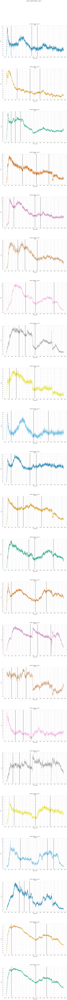

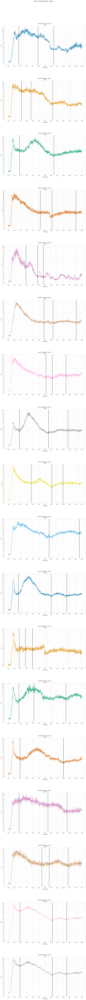

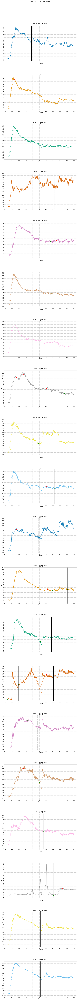

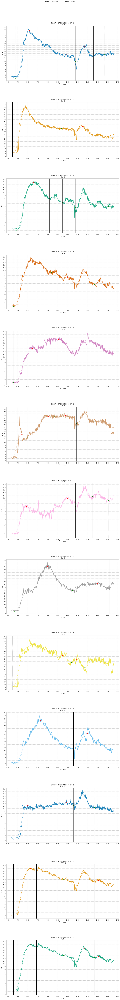

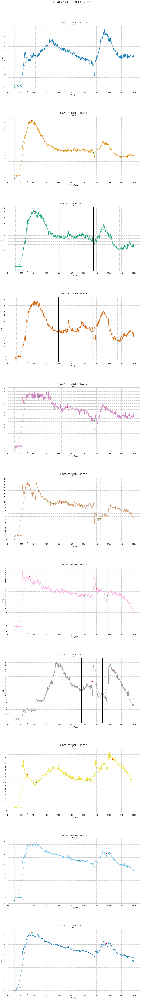

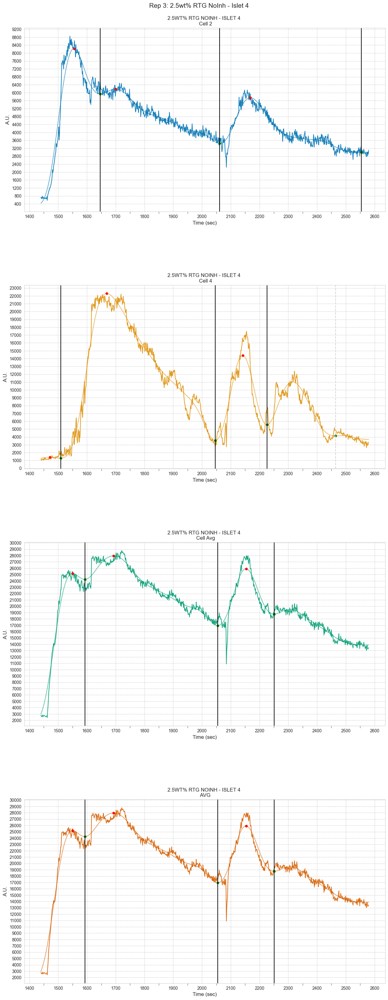

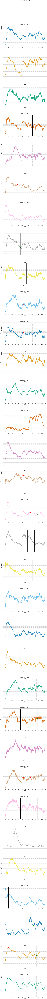

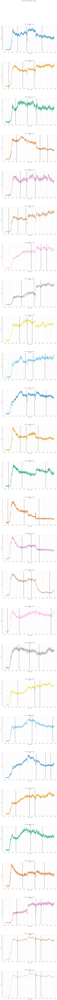

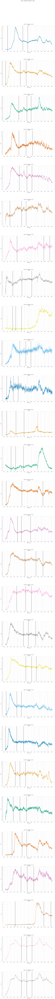

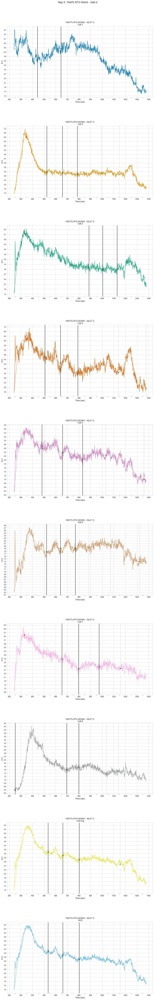

In [28]:
# Find all unique treatments in the DataFrame
treatments = df.Treatment.unique()
# Set the Seaborn style to "whitegrid" with dashed grid lines for better visibility
sns.set_style("whitegrid", {'grid.linestyle': '--'})

# Initialize an empty list to store data for each cell
dfs = []

# Iterate through each unique treatment
for n, treat in enumerate(treatments):

    # Skip treatments that include "Inh" in their name
    if " Inh " in treat:
        continue

    # Filter the DataFrame for the current treatment
    temp_df = df[df["Treatment"] == treat]
    # Filter the metadata DataFrame for the current treatment
    temp_md = md[md["Treatment"] == treat]

    # Find all unique cell numbers for the current treatment
    cells = temp_df["Cell #"].unique()

    # Generate a color palette for the cells
    palette = sns.color_palette("colorblind", len(cells))

    # Create a new figure with subplots, one for each cell
    plt.figure(figsize=(15, int(10*len(cells))))
    plt.subplots_adjust(hspace=0.4)
    plt.suptitle(f"Rep {rep}: {treat}", fontsize=15, y=0.9)

    # Iterate through each cell
    for m, cell in enumerate(cells):
        
        # Find the start and end time for the stimulus window from the metadata
        wind_start = temp_md["11 mM Stimulus"].iloc[0]
        wind_end = temp_md["20 mM Stimulus"].iloc[0]
        # Filter the data for the current cell and time window
        plot_df = temp_df[temp_df["Cell #"] == cell]
        plot_df = plot_df[plot_df["Time (sec)"].between(wind_start, wind_end)]

        # Apply a Butterworth filter to smooth the data
        plot_df = apply_butterworth_filter(plot_df, mode = "smooth")

        # Create a subplot for the current cell
        col_num = 1
        ax = plt.subplot(int(math.ceil(len(cells)/col_num)), col_num, m + 1)

        # Set the x and y-axis labels
        ax.set_xlabel("Time (sec)")
        ax.set_ylabel("A.U.")

        # Plot the original and smoothed data
        sns.lineplot(data = plot_df, x = "Time (sec)", y = "Normalized A.U.", color=palette[m], alpha = 0.9)
        sns.lineplot(data = plot_df, x = "Time (sec)", y = "Smoothed Normalized A.U.", color=palette[m], alpha = 0.6)

        # Find and mark the minima
        inverted_signal = -plot_df["Smoothed Normalized A.U."].values
        min_locations = find_peaks(inverted_signal)[0]  # Add any additional parameters as needed
        mark_locations(ax, plot_df, min_locations, 'dot', 'green')  # Mark minima with green dots

        # Find and mark the maxima, limiting to the first 3
        max_locations = find_peaks(plot_df["Smoothed Normalized A.U."], distance=10, height=5, prominence=0.1)[0][:3]
       
        # Mark the plot with minima and maxima and update metadata
        cell_md_cop = mark_plot_and_update_ends(plot_df, min_locations, max_locations, temp_md, cell, ax)
   
        # Add the updated metadata for the cell to the list
        dfs.append(cell_md_cop)

        # Configure the plot ticks for readability
        configure_plot_ticks(ax, plot_df, False, 20)

        # Set the font size for the axis labels
        ax.set_xlabel("Time (sec)", fontsize=12)
        ax.set_ylabel("A.U.", fontsize=12)
        # Set the title for the subplot
        ax.set_title(f"{treat.upper()} \n {cell}")




